## <p style="text-align: center;"> Τεχνολογία και Ανάλυση Εικόνων και Βίντεο - Ροή Υ </p>
### 2η Εργαστηριακή Άσκηση, Άνοιξη 2021

    'Αμπατζή Ναυσικά (03117198) - nafsika.abatzi@gmail.com'
    'Δήμος Δημήτρης (03117165) - dimitris.dimos647@gmail.com'

### <font color='blue'> 1. Θεωρητικό Μέρος</font>

### <font color='blue'> 2. Υλοποίηση Αλγορίθμου</font>

Το βίντεο που αντιστοιχεί στην ομάδας μας είναι το VIRAT_S_010200_00_000060_000218.mp4.

### <font color='black'> Ερώτημα 1</font>

Κατεβάσαμε τοπικά το παραπάνω βίντεο και για κάθε frame "ρίχνουμε" την ποιότητά του κατά 50% χρησιμοποιώντας την συνάρτηση resize.

In [3]:
import cv2 
import numpy as np
from matplotlib import pyplot as plt
from skimage.util import random_noise
from skimage import filters
from skimage.morphology import disk

In [4]:
cap = cv2.VideoCapture("VIRAT_S_010200_00_000060_000218.mp4")
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
scale = 50
final_height = int(height * scale / 100)
final_width = int(width * scale / 100)
dimens = (final_width,final_height)
result = cv2.VideoWriter("resized_video.mp4", cv2.VideoWriter_fourcc(*'mp4v'), cap.get(cv2.CAP_PROP_FPS), dimens)

while (cap.isOpened()):
    ret, frame = cap.read()
    if not ret:
        break
    result.write(cv2.resize(frame, dimens, interpolation = cv2.INTER_AREA))
cap.release()
result.release()
cv2.destroyAllWindows()

### <font color='black'> Ερώτημα 2</font>

Εφαρμογή των ανιχνευτών γωνιών Harris και Shi-Tomasi για διάφορες παραμέτρους στο πρώτο frame του video. Οι παράμετροι που θα εξεταστούν είναι το maxCorners, το qualityLevel και το minDistance. Πιο αναλυτικά:
* Το maxCorners είναι ο μέγιστος αριθμός των γωνιών που θα επιστραφούν. Σε περίπτωση ύπαρξης περισσότερων από την τιμή του maxCorners, θα επιστραφούν οι πιο έντονες.
* Το qualityLevel είναι η ελάχιστη αποδεκτή ποιότητα γωνιών της εικόνας.
* Το minDistance είναι η ελάχιστη δυνατή Ευκλείδια απόσταση μεταξύ των περιστρεφόμενων γωνιών.

In [32]:
cap = cv2.VideoCapture("resized_video.mp4")
ret, frame1 = cap.read()

# convert to grayscale
frame1_gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)

# different values for parameters
maxCorners = [100,400]
qualityLevels = [0.1,0.2,0.3]
minDistances = [2,4,8]

<ipython-input-33-dec384397a33>:18: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.circle(copy, (x, y), 3, 255, -1)


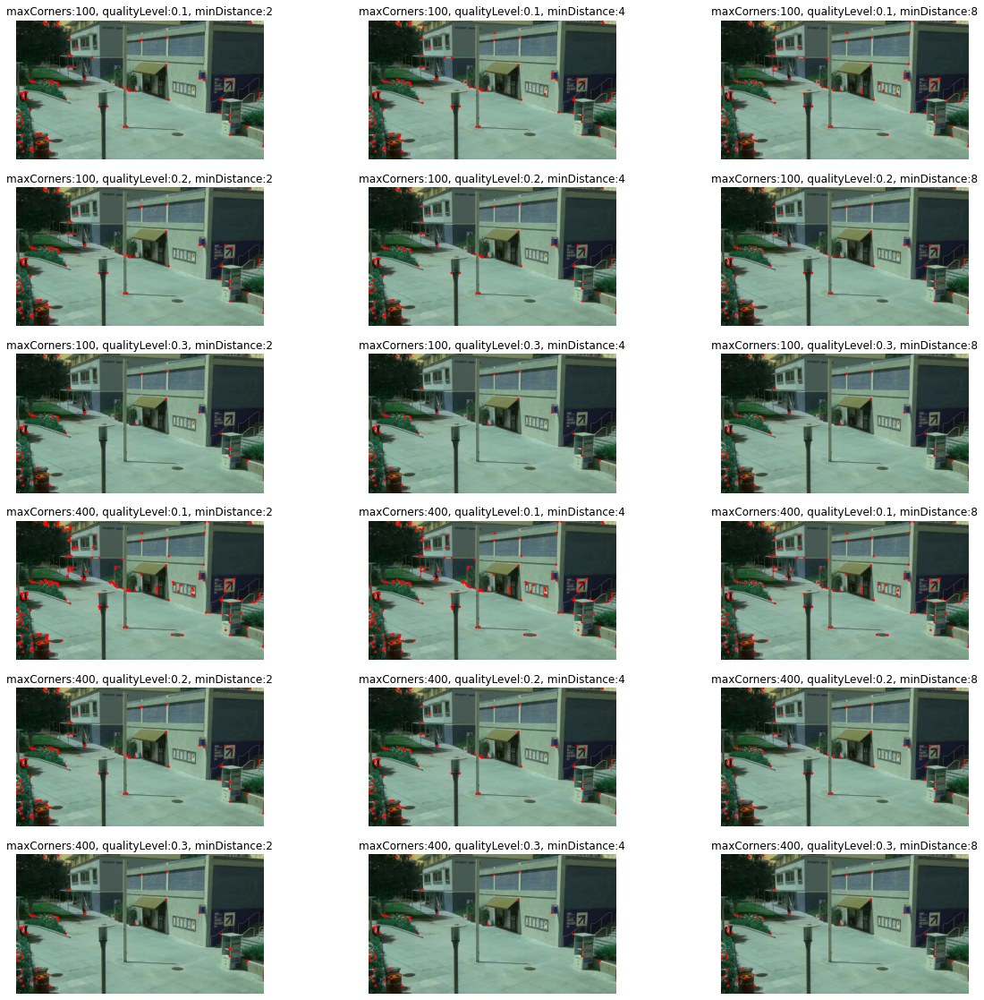

In [33]:
# Harris Corner Detector
cor = []
plot, axs = plt.subplots(6, 3,figsize=(20, 20))
m = 0
for maxNoOfCorners in maxCorners:
    for qualityLevel in qualityLevels:
        n = 0
        for minDistance in minDistances:
            for blocksize in [5]:
                copy = frame1.copy()
                harris = dict(maxCorners = maxNoOfCorners, qualityLevel = qualityLevel, minDistance = minDistance, blockSize = 5, useHarrisDetector = True)
                all_corners = cv2.goodFeaturesToTrack(frame1_gray, **harris)
                cor.append(all_corners)
                cor.append(all_corners)
                # plots 
                for corner in all_corners:
                    x, y = corner.ravel()
                    cv2.circle(copy, (x, y), 3, 255, -1)
                axs[m][n].set_title("maxCorners:{}, qualityLevel:{}, minDistance:{}".format(maxNoOfCorners,qualityLevel,minDistance))
                axs[m][n].imshow(copy,cmap = "gray")
                axs[m][n].axis("off")
                n = n + 1
        m = m + 1

Παρατηρούμε ότι (όπως, άλλωστε θα αναμέναμε) η αύξηση της παραμέτρου maxNoOfCorners συνεπάγεται τον εντοπισμό περισσοτέρων γωνιών. Όταν η παράμετρος qualityLevel αυξάνεται, το πλήθος των γωνιών που ανιχνεύονται είναι μικρότερο και όταν το minDistance αυξάνεται τότε οι γωνίες που ανιχνεύονται είναι περισσότερες. Συγκεκριμένα, για το qualityLevel, μπορούμε να εξηγήσουμε την αντίστροφη αναλογία του με το πλήθος των εντοπιζόμενων γωνιών ως εξής: όταν η ποιότητα των εντοπιζόμενων γωνιών αυξάνεται, τότε οι γωνίες αυτές είναι όλο και πιο έντονες κι, επομένως, είναι αναμενόμενο να είναι λιγότερες.

Όσον αφορά στην αποτελεσματικότητα της ανίχνευσης, θα θέλαμε να εντοπίζονται γωνίες που a priori γνωρίζουμε (είναι για τον ανθρώπινο οφθαλμό εμφανείς, δηλαδή) ότι βρίσκονται εκεί. Βέβαια, η εικόνα της αποτελεσματικότερης ανίχνευσης δεν είναι απαραίτητα και η πιο χρήσιμη για τα όσα θα επιδιώξουμε στη συνέχεια (εντοπισμός κίνησης).

Ως προς την ανίχνευση γωνιών θα επιλέγαμε μια εικόνα όπως αυτή που προκύπτει με τον εξής συνδυασμό παραμέτρων:

$$
\begin{array}{ccc}
    maxNoOfCorners & qualityLevel & minDistance \\\hline
    1 & 2 & 3
\end{array}
$$

<ipython-input-34-ff9f1e968ded>:18: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  cv2.circle(copy, (x, y), 3, 255, -1)


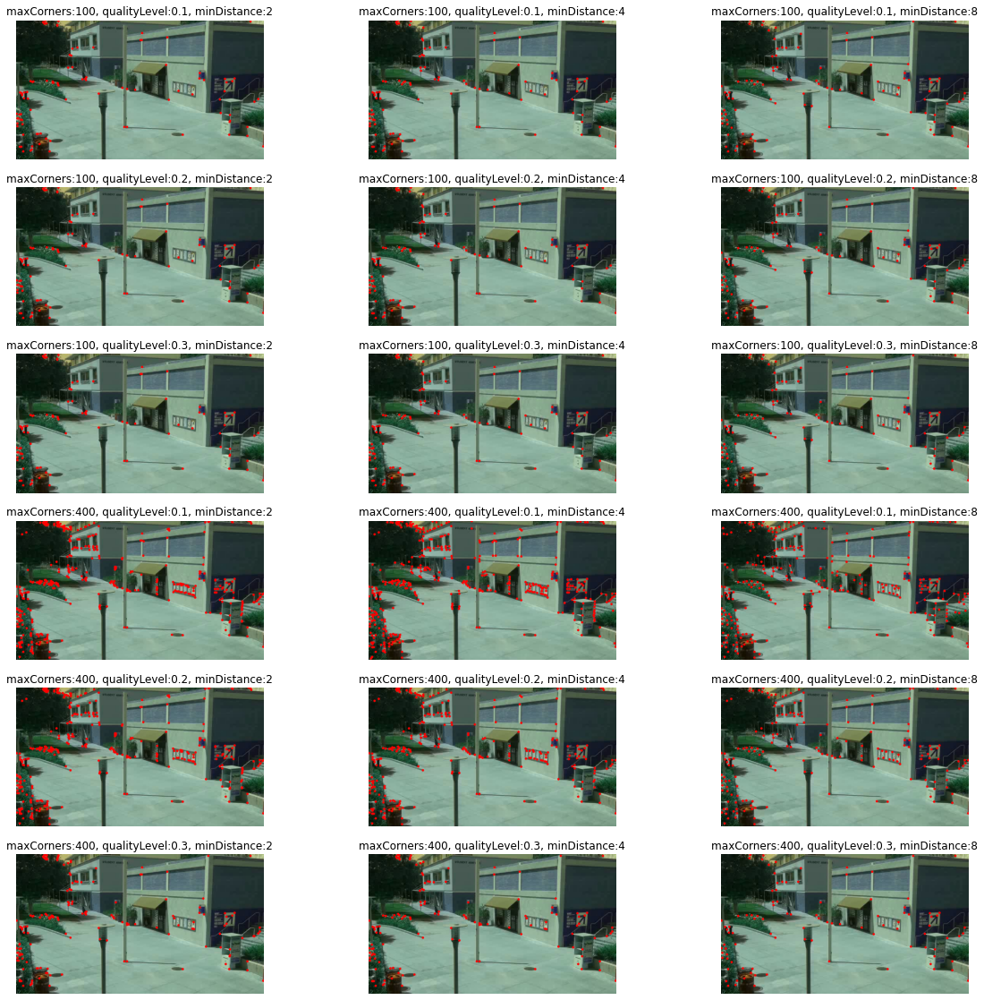

In [34]:
# Shi-Tomasi Corner Detector
cor = []
plot, axs = plt.subplots(6, 3,figsize=(20, 20))
m = 0
for maxNoOfCorners in maxCorners:
    for qualityLevel in qualityLevels:
        n = 0
        for minDistance in minDistances:
            for blocksize in [5]:
                copy = frame1.copy()
                harris = dict(maxCorners = maxNoOfCorners, qualityLevel = qualityLevel, minDistance = minDistance, blockSize = 5, useHarrisDetector = False)
                all_corners = cv2.goodFeaturesToTrack(frame1_gray, **harris)
                cor.append(all_corners)
                cor.append(all_corners)
                # plots 
                for corner in all_corners:
                    x, y = corner.ravel()
                    cv2.circle(copy, (x, y), 3, 255, -1)
                axs[m][n].set_title("maxCorners:{}, qualityLevel:{}, minDistance:{}".format(maxNoOfCorners,qualityLevel,minDistance))
                axs[m][n].imshow(copy,cmap = "gray")
                axs[m][n].axis("off")
                n = n + 1
        m = m + 1

Διαπιστώνουμε και με την εφαρμογή του Shi-Tomasi ότι οι μεταβολές των παραμέτρων συνεπάγονται τα ίδια αποτελέσματα με παραπάνω. Επιλέγουμε ως βέλτιστη εικόνα ανίχνευσης την εικόνα με παραμέτρους:

$$
\begin{array}{ccc}
    maxNoOfCorners & qualityLevel & minDistance \\\hline
    1 & 2 & 3
\end{array}
$$

Ο αλγόριθμος Shi-Tomasi φαίνεται να είναι πιο εύστοχος ως προς τον εντοπισμό γωνιών σε σχέση με τον Harris.

### <font color='black'> Ερώτημα 3</font>

Εφαρμογή του αλγορίθμου Lucas-Canade για υπολογισμό optical flow στα Harris και Shi-Tomasi σημεία που επιλέχθηκαν στο προηγούμενο ερώτημα. Θα πειραμαστιστούμε με τις παραμέτρους winSize, maxLevel και criteria. Πιο αναλυτικά:
* Το winSize είναι το μέγεθος του παραθύρου σε επίπεδο της πυραμίδας.
* Το maxLevel είναι ο αριθμός του μέγιστου επιπέδου πυραμίδας με βάση το 0.
* Το criteria καθορίζουν τα κριτήρια τερματισμού του επαναληπτικού αλγορίθμου αναζήτησης.

In [35]:
# best Harris result 
parameters = dict(maxCorners = 200, qualityLevel = 0.2, minDistance = 8, blockSize = 5, useHarrisDetector = True)
harris = cv2.goodFeaturesToTrack(frame1_gray, **parameters)

# best Shi-Tomasi result 
parameters = dict(maxCorners = 100, qualityLevel = 0.1, minDistance = 4, blockSize = 5, useHarrisDetector = False)
shi_tomasi = cv2.goodFeaturesToTrack(frame1_gray, **parameters) 

In [36]:
def Optical_Flow(winSize, maxLevel, criteria, corners):
    cap = cv2.VideoCapture("resized_video.mp4")
    ret, c = cap.read()
    frame1_gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)
    color = (0, 0, 255)
    # create dictionary with Lucas Kanade parameters
    Lucas_Kanade = dict(winSize = winSize, maxLevel = maxLevel, criteria = criteria) 
    # Create a mask image for drawing purposes
    mask = np.zeros_like(frame1)
    while(cap.isOpened()):
        ret, frame = cap.read()
        if not ret:
            break
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) 
        # calculate optical flow
        p1, st, err = cv2.calcOpticalFlowPyrLK(frame1_gray, gray, corners, None, **Lucas_Kanade) 
        good_old = corners[st == 1]   #good features prev position
        good_new = p1[st == 1]   #good features next position
        for i, (new, old) in enumerate(zip(good_new, good_old)):
            a, b = new.ravel()   
            c, d = old.ravel()  
            mask = cv2.line(mask, (a, b), (c, d), color, 2)  
            frame = cv2.circle(frame, (a, b), 3, color, -1)   
        output = cv2.add(frame, mask)
        frame1_gray = gray.copy()  
        corners = good_new.reshape(-1, 1, 2)
        cv2.imshow("sparse optical flow", output)
        k = cv2.waitKey(30) & 0xff
        if k == 27:
            break
    cap.release()

In [37]:
# Optical Flow for Harris - different parameters
Optical_Flow((15, 15), 2, (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03), harris)

<ipython-input-36-7b70e3d6fcdd>:22: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  mask = cv2.line(mask, (a, b), (c, d), color, 2)   #line between old and new position
<ipython-input-36-7b70e3d6fcdd>:23: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  frame = cv2.circle(frame, (a, b), 3, color, -1)   #spot at the new position


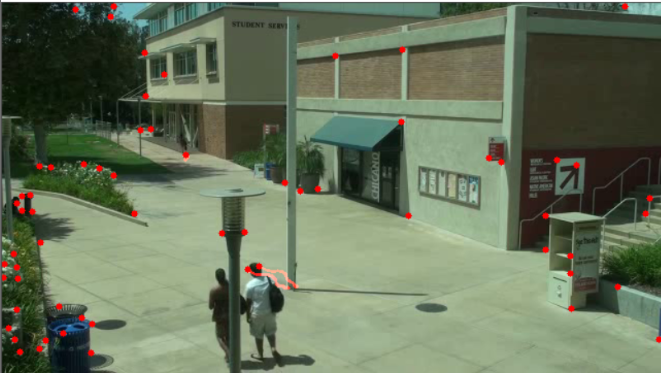

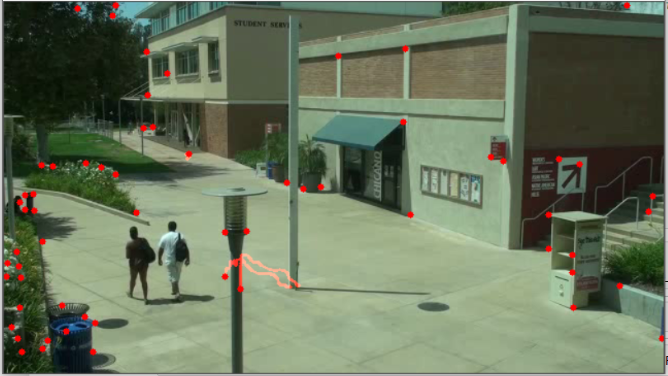

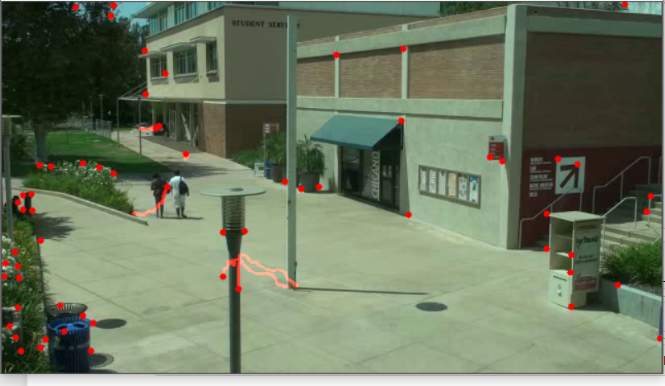

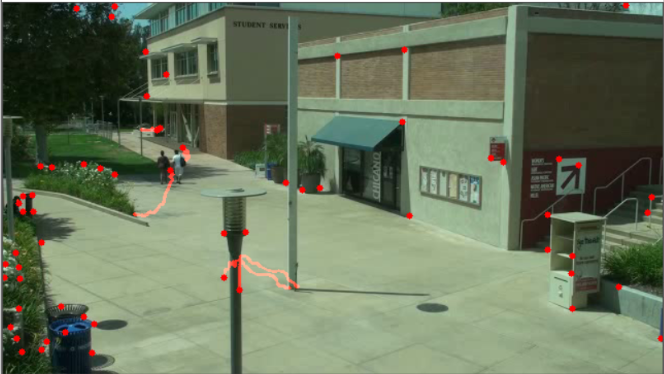

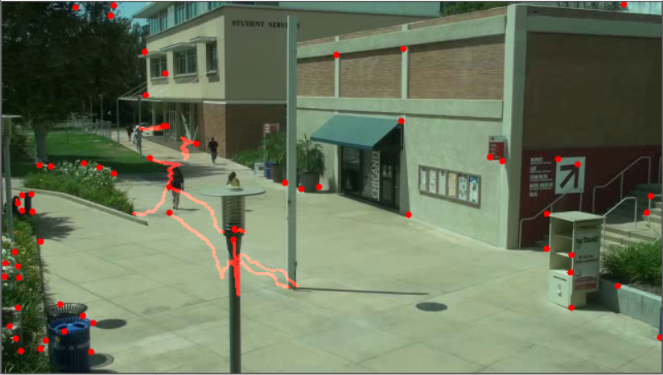

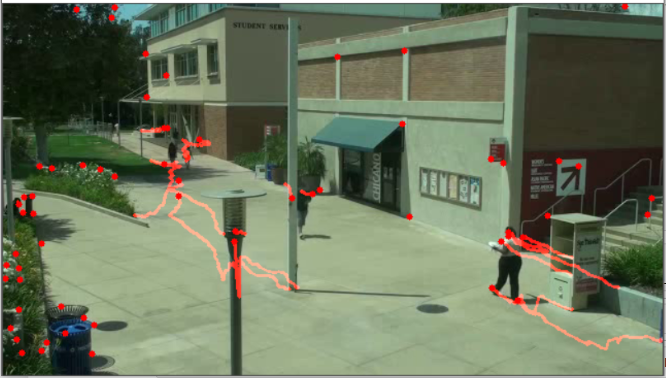

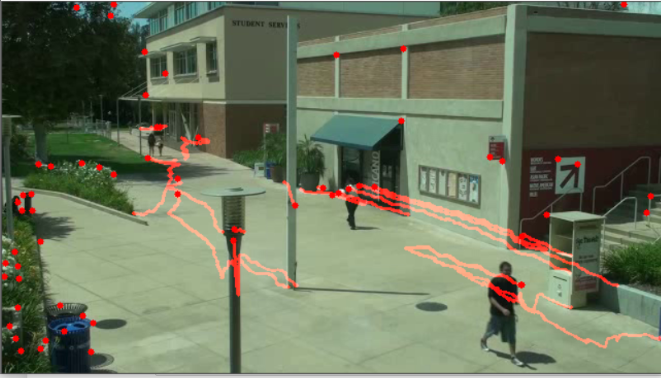

In [2]:
from IPython.display import Image, display

listOfImageNames = ['part3/15_2_10_0.03/1.png',
                    'part3/15_2_10_0.03/2.png',
                    'part3/15_2_10_0.03/3.png',
                    'part3/15_2_10_0.03/4.png',
                    'part3/15_2_10_0.03/5.png',
                    'part3/15_2_10_0.03/6.png',
                    'part3/15_2_10_0.03/7.png',]

for imageName in listOfImageNames:
    display(Image(filename=imageName))

In [10]:
Optical_Flow((30,30),3, (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 15, 0.06), harris)

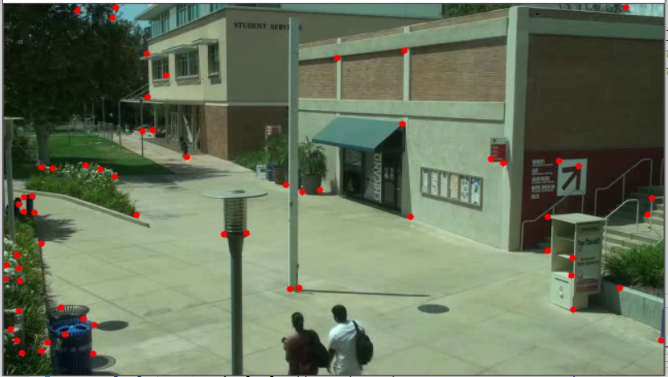

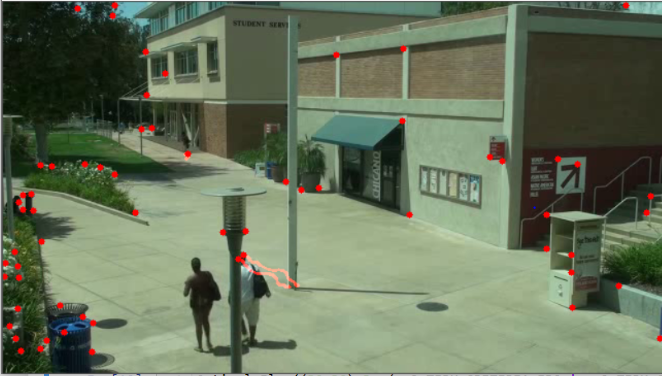

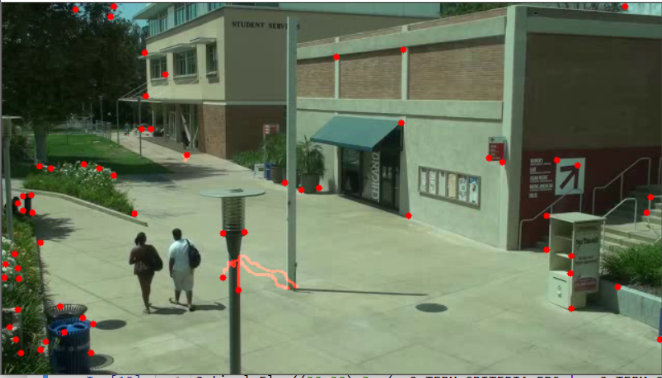

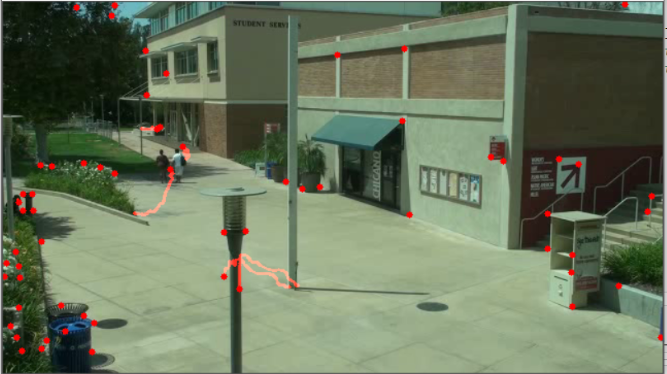

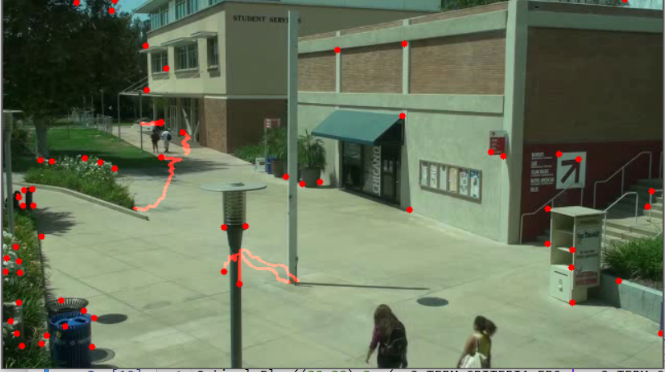

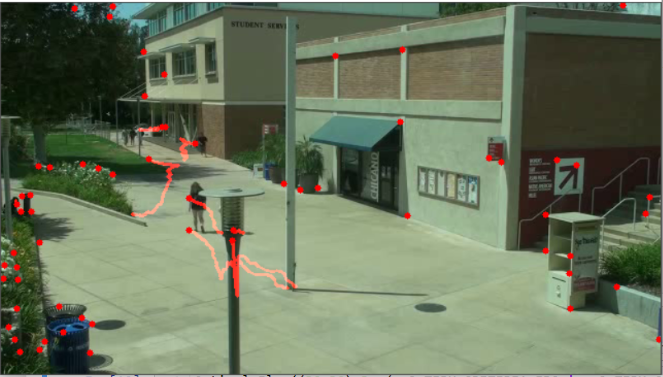

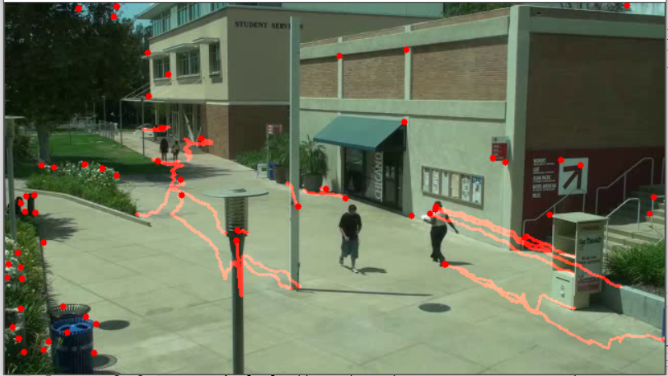

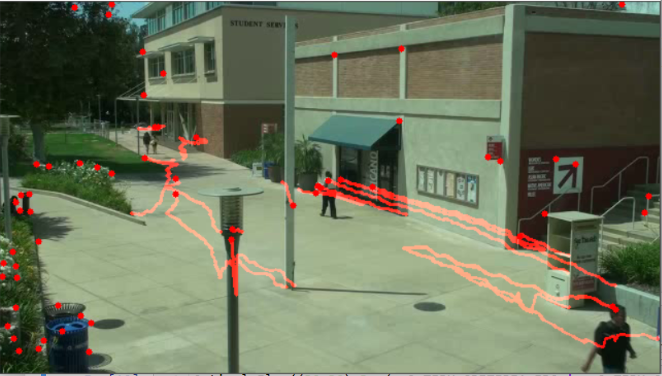

In [3]:
listOfImageNames = ['part3/30_3_15_0.06/1.png',
                    'part3/30_3_15_0.06/2.png',
                    'part3/30_3_15_0.06/3.png',
                    'part3/30_3_15_0.06/4.png',
                    'part3/30_3_15_0.06/5.png',
                    'part3/30_3_15_0.06/6.png',
                    'part3/30_3_15_0.06/7.png',
                    'part3/30_3_15_0.06/9.png']

for imageName in listOfImageNames:
    display(Image(filename=imageName))

In [12]:
Optical_Flow((5,5),1, (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 5, 0.01), harris)

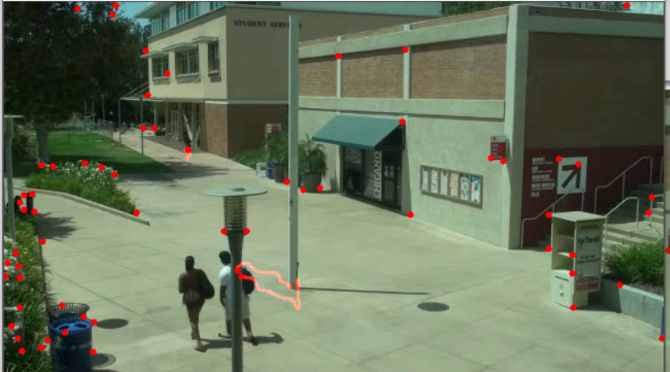

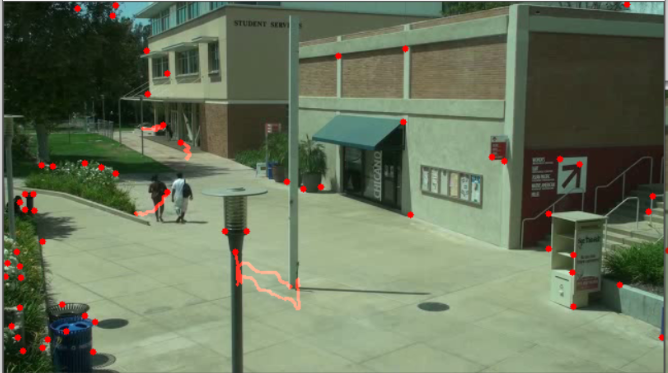

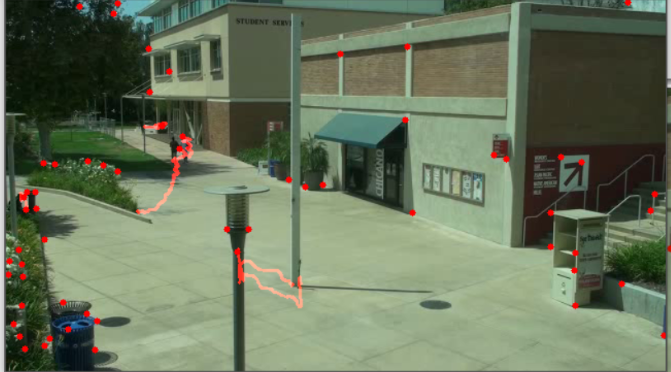

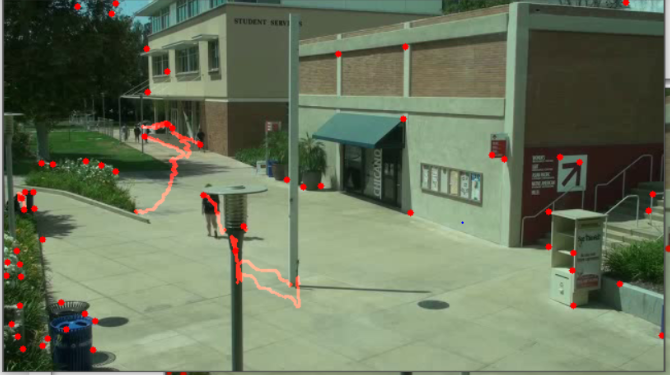

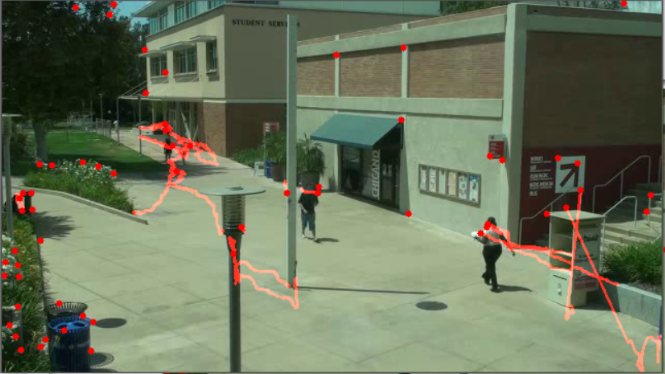

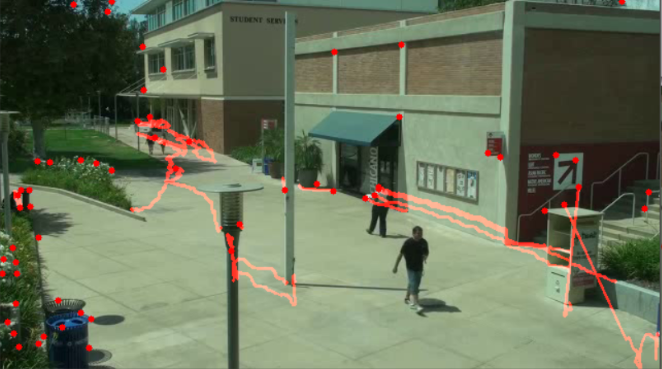

In [4]:
listOfImageNames = ['part3/5_1_5_0.01/1.png',
                    'part3/5_1_5_0.01/2.png',
                    'part3/5_1_5_0.01/3.png',
                    'part3/5_1_5_0.01/4.png',
                    'part3/5_1_5_0.01/5.png',
                    'part3/5_1_5_0.01/6.png']

for imageName in listOfImageNames:
    display(Image(filename=imageName))

In [14]:
# Optical Flow for Shi-Tomasi - different parameters
Optical_Flow((15, 15), 2, (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03), shi_tomasi)

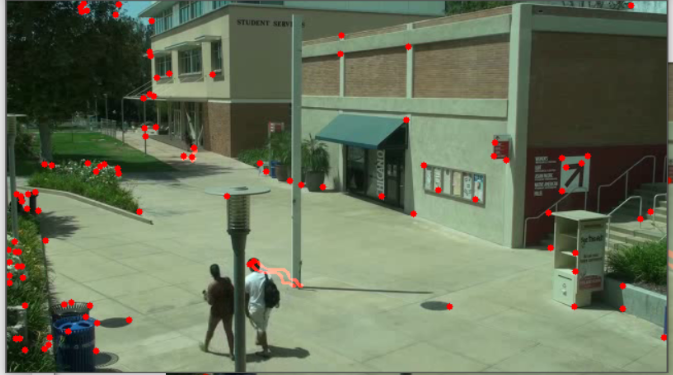

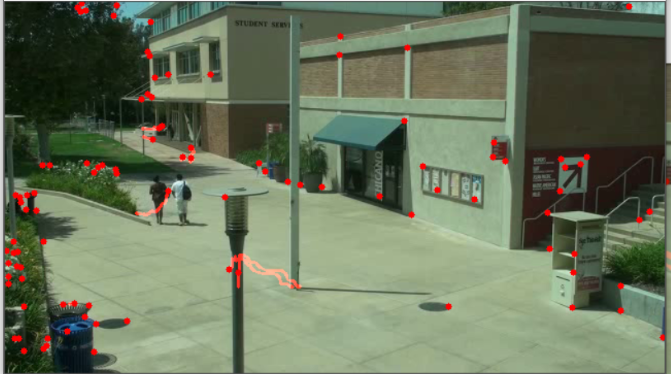

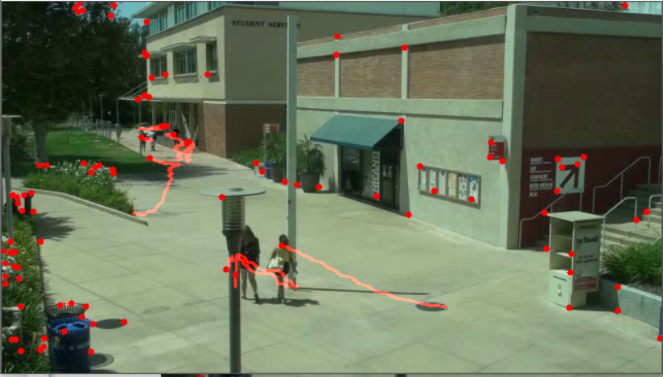

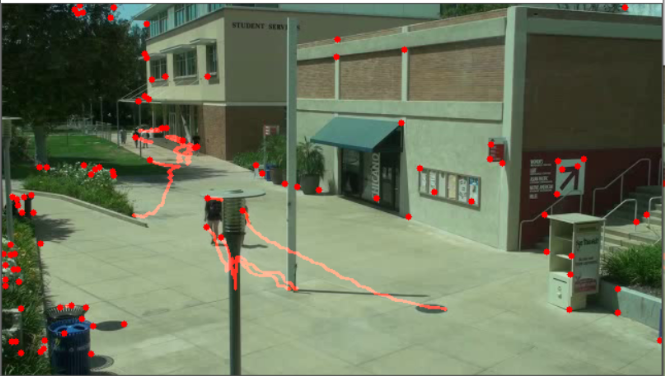

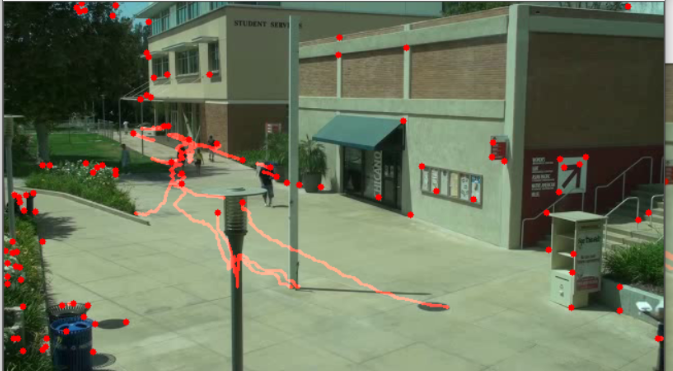

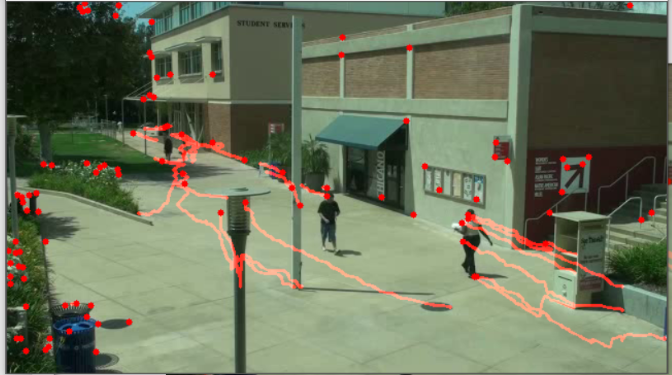

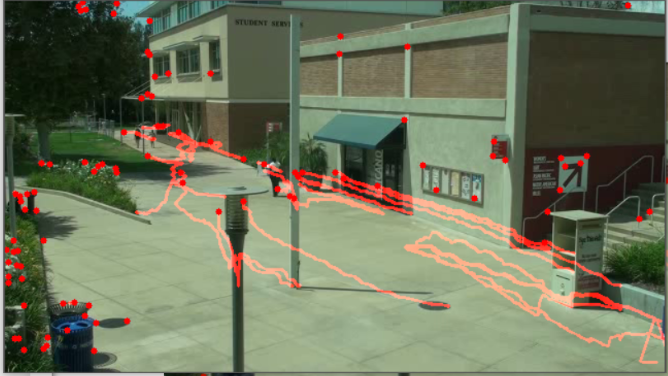

In [5]:
listOfImageNames = ['part3_shi_tomasi/15_2_10_0.03/1.png',
                    'part3_shi_tomasi/15_2_10_0.03/2.png',
                    'part3_shi_tomasi/15_2_10_0.03/3.png',
                    'part3_shi_tomasi/15_2_10_0.03/4.png',
                    'part3_shi_tomasi/15_2_10_0.03/5.png',
                    'part3_shi_tomasi/15_2_10_0.03/6.png',
                    'part3_shi_tomasi/15_2_10_0.03/7.png',]

for imageName in listOfImageNames:
    display(Image(filename=imageName))

In [16]:
Optical_Flow((30,30),3, (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 15, 0.06), shi_tomasi)

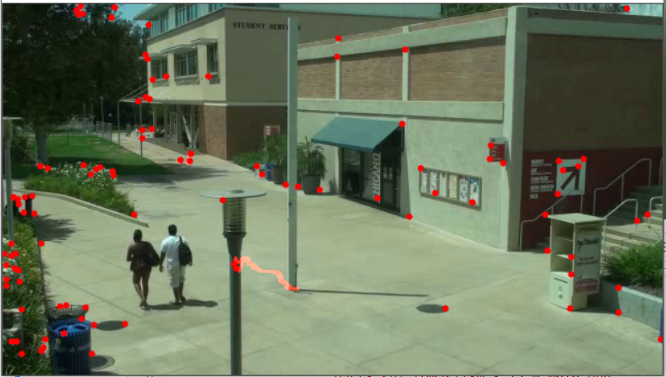

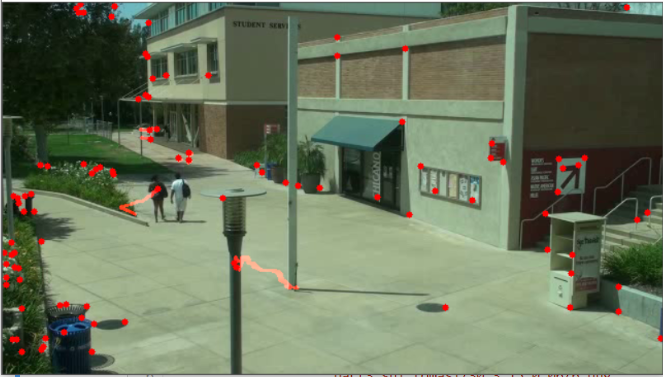

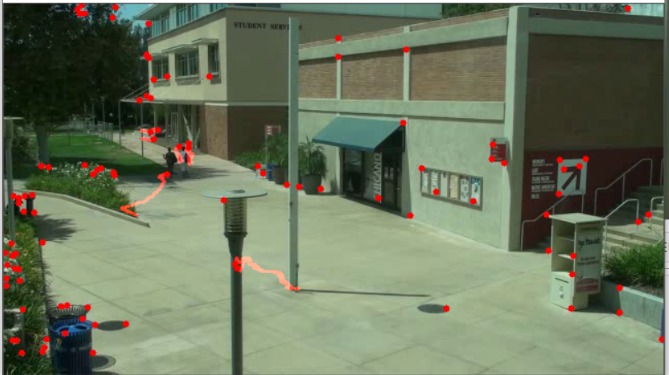

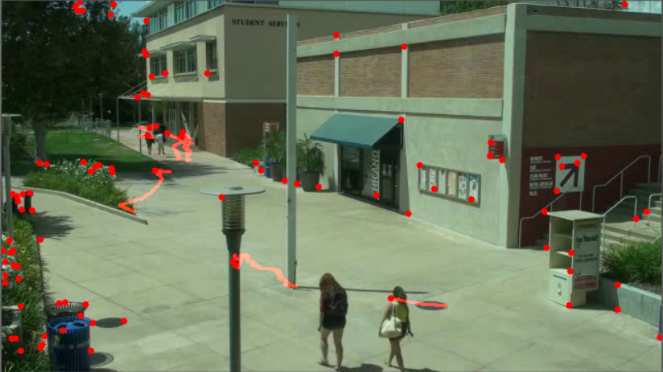

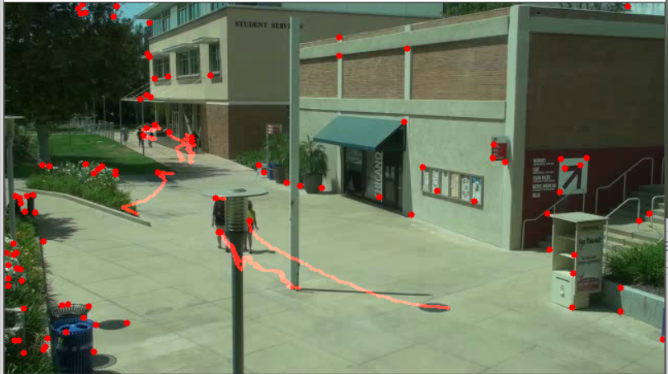

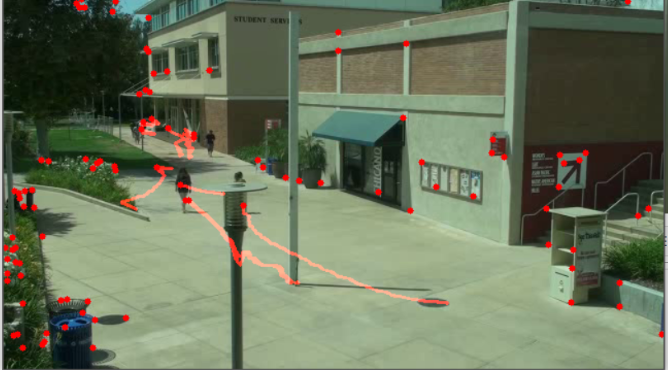

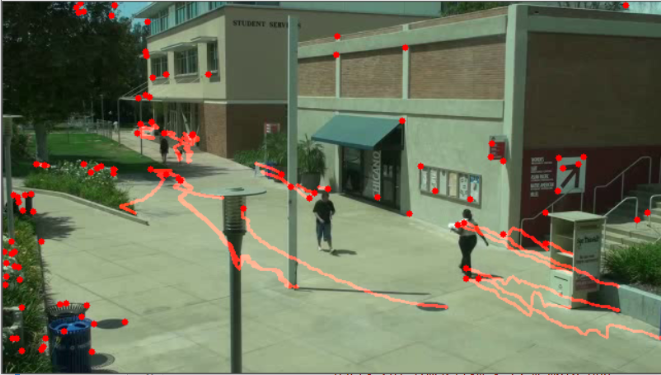

In [6]:
listOfImageNames = ['part3_shi_tomasi/30_3_15_0.06/1.png',
                    'part3_shi_tomasi/30_3_15_0.06/2.png',
                    'part3_shi_tomasi/30_3_15_0.06/3.png',
                    'part3_shi_tomasi/30_3_15_0.06/4.png',
                    'part3_shi_tomasi/30_3_15_0.06/5.png',
                    'part3_shi_tomasi/30_3_15_0.06/6.png',
                    'part3_shi_tomasi/30_3_15_0.06/7.png']

for imageName in listOfImageNames:
    display(Image(filename=imageName))

In [18]:
Optical_Flow((5,5),1, (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 5, 0.01), shi_tomasi)

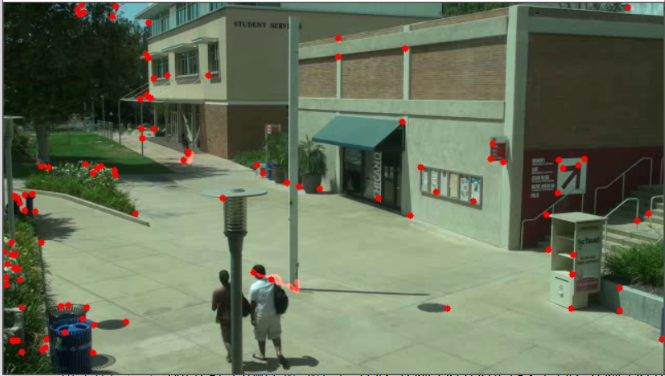

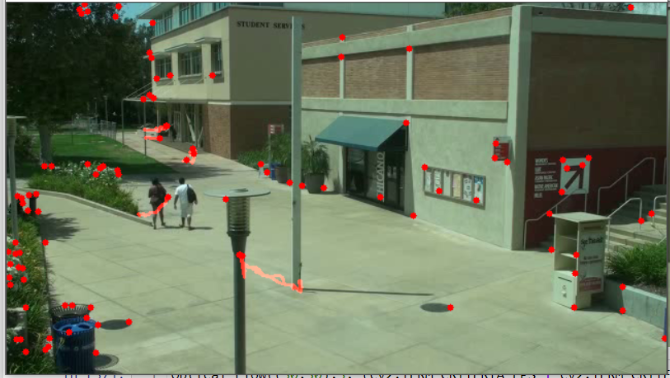

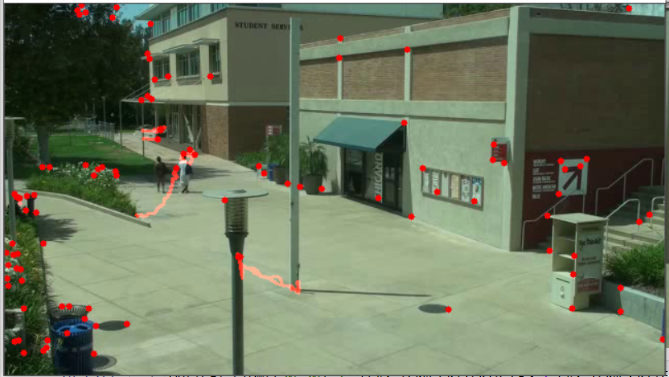

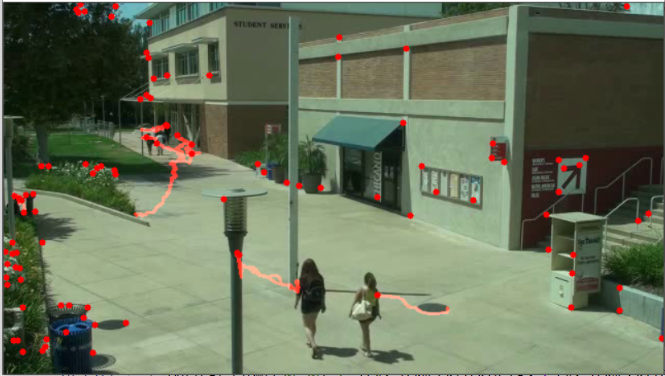

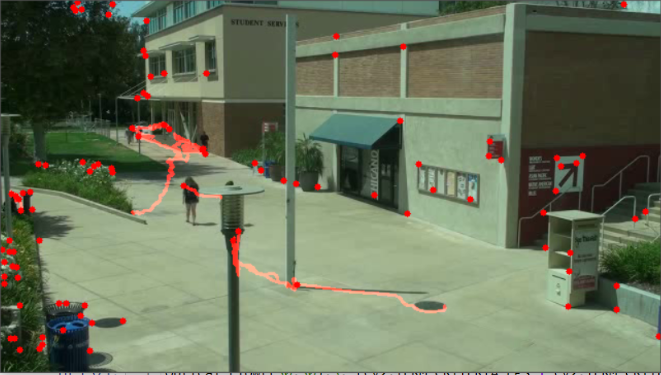

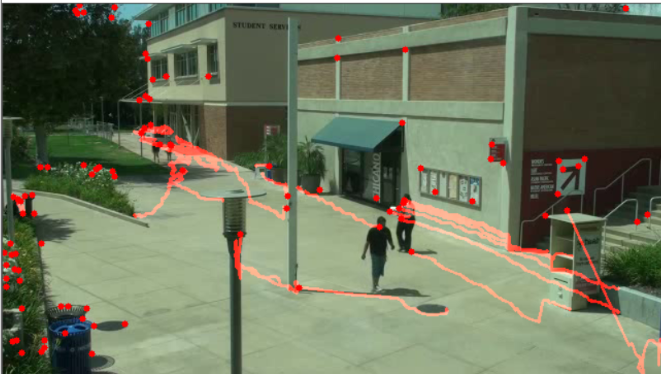

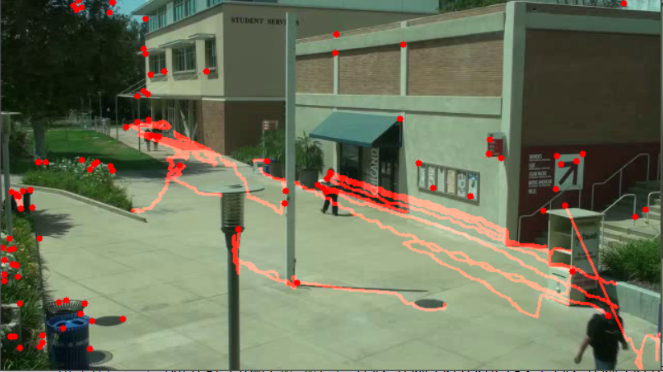

In [7]:
listOfImageNames = ['part3_shi_tomasi/5_1_5_0.01/1.png',
                    'part3_shi_tomasi/5_1_5_0.01/2.png',
                    'part3_shi_tomasi/5_1_5_0.01/3.png',
                    'part3_shi_tomasi/5_1_5_0.01/4.png',
                    'part3_shi_tomasi/5_1_5_0.01/5.png',
                    'part3_shi_tomasi/5_1_5_0.01/6.png',
                    'part3_shi_tomasi/5_1_5_0.01/7.png']

for imageName in listOfImageNames:
    display(Image(filename=imageName))

### <font color='black'> Ερώτημα 4</font>

Τροποποίηση του κώδικα του Ερωτήματος 3 με στόχο την παρακολούθηση γωνιών Harris και Shi-Tomasi που εμφανίζονται στο βίντεο, μετά το πρώτο frame. Θα χρησιμοποιηθούν οι παράμετροι που μας έδωσαν καλύτερα αποτελέσματα στα βήματα 2 και 3.

In [10]:
def LucasKanade2( detector, noise, noise_param):
    # initialize different parameters
    color = (0, 0, 255)
    counter_frame = 0
    dis = 0.3
    refresh = 30

    cap = cv2.VideoCapture("resized_video.mp4")
    ret, frame1 = cap.read()

    # check if Salt and Pepper noise
    if noise == False:
         frame1_gray = cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY)  
    else:
         frame1_gray = (random_noise(cv2.cvtColor(frame1, cv2.COLOR_BGR2GRAY), mode = 's&p', seed = 6, amount = noise_param) * 255).astype(np.uint8)
    mask = np.zeros_like(frame1)

    if(detector == 'Harris'):
        p = dict(maxCorners = 200, qualityLevel = 0.2, minDistance = 8, blockSize = 5, useHarrisDetector = True)
        p0 = cv2.goodFeaturesToTrack(frame1_gray, **p)
    if(detector == 'Shi-Tomasi'):
        p = dict(maxCorners = 100, qualityLevel = 0.1, minDistance = 4, blockSize = 5, useHarrisDetector = False)
        p0 = cv2.goodFeaturesToTrack(frame1_gray, **p)

    while(cap.isOpened()):
        ret, frame = cap.read()
        if not ret:
            break
        counter_frame += 1
        if noise==False:
            grayscale = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        else:
           # add noise
            grayscale = (random_noise(cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY), mode = 's&p', seed = 6, amount = noise_param) * 255).astype(np.uint8)
        
        parameters = dict(winSize = (30, 30), maxLevel = 3, criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 15, 0.06))
        p1, status, error = cv2.calcOpticalFlowPyrLK(frame1_gray, grayscale, p0, None, **parameters)
        good_old = p0[status == 1]
        good_new = p1[status == 1]
        for i, (new, old) in enumerate(zip(good_new, good_old)):
            a, b = new.ravel()
            c, d = old.ravel()
            # euroclean 
            if np.sqrt((b - d) ** 2 + (a - c) ** 2) >= dis: 
                mask = cv2.line(mask, (a, b), (c, d), color, 2)
                frame = cv2.circle(frame, (a, b), 3, color, -1)

        result = cv2.add(frame, mask)
        frame1_gray = grayscale.copy()
        p0 = good_new.reshape(-1, 1, 2)
        cv2.imshow("sparse optical flow", result)

        if counter_frame == refresh:
            counter_frame = 0
            if(detector == 'Harris'):
                p = dict(maxCorners = 200, qualityLevel = 0.2, minDistance = 8, blockSize = 5, useHarrisDetector = True)
                p0 = cv2.goodFeaturesToTrack(frame1_gray, **p)
            if(detector == 'Shi-Tomasi'):
                p = dict(maxCorners = 100, qualityLevel = 0.1, minDistance = 4, blockSize = 5, useHarrisDetector = False)
                p0 = cv2.goodFeaturesToTrack(frame1_gray, **p)

        if cv2.waitKey(10) & 0xFF == ord('q'):
            break
    cap.release()


In [11]:
# Lucas Detector
LucasKanade2('Harris',False,0.05)

KeyboardInterrupt: 

In [ ]:
# Shi-Tomasi Detector
LucasKanade2('Shi-Tomasi',False,0.05)

### <font color='black'> Ερώτημα 5</font>

Εισαγωγή Salt and Pepper θoρύβου μετά από κάθε διάβασμα ενός frame. Θα χρησιμοποιηθεί η συνάρτηση του προηγούμενου ερωτήματος με αλλαγή της παραμέτρου noise σε True.

In [7]:
# Lucas Detector
LucasKanade2('Harris', True, 0.05)

NameError: name 'noiseAmount' is not defined

In [12]:
# Lucas Detector
LucasKanade2('Harris', True, 0.2)

KeyboardInterrupt: 

In [ ]:
# Shi-Tomasi Detector
LucasKanade2('Shi-Tomasi',True, 0.05)

In [13]:
# Shi-Tomasi Detector
LucasKanade2('Shi-Tomasi',True, 0.2)

KeyboardInterrupt: 